In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
tqdm.pandas()

In [2]:
movies = pd.read_csv("mv-1m_movies_rf.csv")
ratings = pd.read_csv("mv-1m_rating_rf.csv")
users = pd.read_csv("mv-1m_user_rf.csv")

In [3]:
links_Meta = pd.read_csv("links_Meta.csv")

In [4]:
#some genres are missing in movie_data
print(movies.head(2)) 
print('\n')
print(ratings.head(2))
print('\n')
print(users.head(2))
print('\n')
print(links_Meta.head(2))

   movieId             title                                       genres  \
0        1  Toy Story (1995)  Adventure|Animation|Children|Comedy|Fantasy   
1        2    Jumanji (1995)                   Adventure|Children|Fantasy   

   year  
0  1995  
1  1995  


   userId  movieId  rating
0       1     1193       5
1       1      661       3


   userId gender  age     occupation zipcode
0       1      F    1   K-12 student   48067
1       2      M   56  self-employed   70072


   movieId  imdbId  tmdbId                                          meta_data
0        1  114709   862.0  {'adult': False, 'backdrop_path': '/3Rfvhy1Nl6...
1        2  113497  8844.0  {'adult': False, 'backdrop_path': '/dH5BdTa6iS...


In [5]:
#24 entries are missing in genre
movies.info()   

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3883 entries, 0 to 3882
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   movieId  3883 non-null   int64 
 1   title    3883 non-null   object
 2   genres   3859 non-null   object
 3   year     3883 non-null   int64 
dtypes: int64(2), object(2)
memory usage: 121.5+ KB


In [6]:
ratings.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000209 entries, 0 to 1000208
Data columns (total 3 columns):
 #   Column   Non-Null Count    Dtype
---  ------   --------------    -----
 0   userId   1000209 non-null  int64
 1   movieId  1000209 non-null  int64
 2   rating   1000209 non-null  int64
dtypes: int64(3)
memory usage: 22.9 MB


In [7]:
users.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6040 entries, 0 to 6039
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   userId      6040 non-null   int64 
 1   gender      6040 non-null   object
 2   age         6040 non-null   int64 
 3   occupation  6040 non-null   object
 4   zipcode     6040 non-null   object
dtypes: int64(2), object(3)
memory usage: 236.1+ KB


In [8]:
#some userID movieID were in integer format so changed the formAT FOR ALL THE DATA
movies["movieId"] = movies["movieId"].astype(str)
ratings[['userId','movieId']] =ratings[['userId', 'movieId']].astype(str)
users['userId'] = users['userId'].astype(str)
links_Meta["movieId"] = links_Meta["movieId"].astype(str)

In [9]:
#all users in users dataset are one line entry
users["userId"].nunique()

6040

In [10]:
#ratings are integers from 1 to 5
print(ratings["rating"].value_counts())
print(ratings.nunique())

4    348971
3    261197
5    226310
2    107557
1     56174
Name: rating, dtype: int64
userId     6040
movieId    3706
rating        5
dtype: int64


In [11]:
#ALL USERS have given alteast 1 rating
# ALL Movies DOES NOT have ratings (about 177 movies dont have rating)

from pandasql import sqldf 
mysql = lambda q: sqldf(q, globals())
query = '''
SELECT count(distinct movieId)
FROM movies
where movieId not in (select distinct movieId from ratings);
'''
mysql(query)  

,count(distinct movieId)
0,177


In [12]:
# MADE THE YEAR column in the movies datadet
#movies["year"] =
movies["year"] = movies["title"].str[-5:].str[:-1]

In [ ]:
#insights in user data
users.head(2)

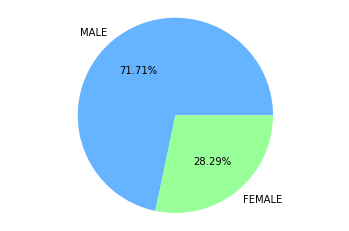

In [13]:
labels = ["MALE", "FEMALE"]
plt.pie(users["gender"].value_counts(), colors = ['#66b3ff','#99ff99'], autopct="%.2f%%",labels=labels)
plt.axis("equal")
plt.show()

In [14]:
#80% of the population is younger population
age_freq = users["age"].value_counts(normalize=True)
#print(dummy)

<AxesSubplot:>

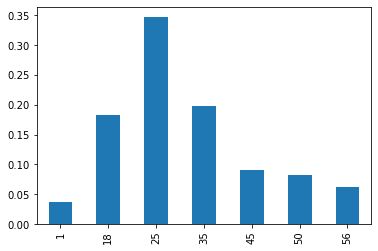

In [15]:
age_freq[age_freq.index.sort_values()].plot(kind='bar')

In [16]:
users["occupation"].value_counts().head(5)

college/grad student    759
other/ns                711
executive/managerial    679
academic/educator       528
technician/engineer     502
Name: occupation, dtype: int64

In [ ]:
users["zipcode"].nunique()

In [ ]:
links_Meta.head(2)

In [17]:
#Basically calculating the counts of movies that are drama based or comedy or thriller etc
#These Genres are not disjoint sets (they do have common movies)
from pandasql import sqldf 
mysql = lambda q: sqldf(q, globals())
def genre_count(x):
    query = '''
    
    SELECT count(*) as count
    FROM movies
    WHERE genres like '%{}%';
    '''.format(x)
    return mysql(query).loc[0,"count"]

In [18]:
genre_master = pd.read_csv("Genre_list.csv")

In [19]:
genre_master["counts"] = genre_master["genre_category"].apply(genre_count)

In [20]:
genre_master.to_csv('Genre_List_with_counts.csv',index=False) 

In [21]:
total_movies = movies["movieId"].nunique()
total_movies

3883

In [22]:
genre_master["%counts"] = genre_master["counts"]/total_movies

<AxesSubplot:xlabel='genre_category', ylabel='%counts'>

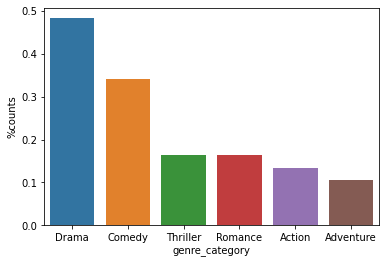

In [23]:
genre_master.sort_values(by = ['%counts'], ascending = [False],inplace= True)
sns.barplot(x='genre_category',y='%counts',data=genre_master.head(6),estimator=np.sum)

## MERGING ALL THE DATASETS

In [24]:
#From year 1919 to 2000 year movies are kept
year_freq = movies["year"].value_counts(normalize=True)
year_freq.index.min()

'1919'

In [25]:
ratings.sort_values(by = ['userId', 'movieId'], ascending = [True, True],inplace=True)
movies.sort_values(by = ['movieId'], ascending = [True],inplace=True)

In [26]:
ratings = ratings.merge(movies,left_on=['movieId'],right_on=['movieId'],how="left")
ratings.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1000209 entries, 0 to 1000208
Data columns (total 6 columns):
 #   Column   Non-Null Count    Dtype 
---  ------   --------------    ----- 
 0   userId   1000209 non-null  object
 1   movieId  1000209 non-null  object
 2   rating   1000209 non-null  int64 
 3   title    1000209 non-null  object
 4   genres   998034 non-null   object
 5   year     1000209 non-null  object
dtypes: int64(1), object(5)
memory usage: 53.4+ MB


In [27]:
links_Meta.sort_values(by = ['movieId'], ascending = [True],inplace=True)

In [28]:
ratings = ratings.merge(links_Meta[["movieId","meta_data"]],left_on=['movieId'],right_on=['movieId'],how="left")
ratings.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1000209 entries, 0 to 1000208
Data columns (total 7 columns):
 #   Column     Non-Null Count    Dtype 
---  ------     --------------    ----- 
 0   userId     1000209 non-null  object
 1   movieId    1000209 non-null  object
 2   rating     1000209 non-null  int64 
 3   title      1000209 non-null  object
 4   genres     998034 non-null   object
 5   year       1000209 non-null  object
 6   meta_data  998034 non-null   object
dtypes: int64(1), object(6)
memory usage: 61.0+ MB


In [29]:
users.sort_values(by = "userId",ascending = [True],inplace=True)
ratings.sort_values(by = "userId",ascending = [True],inplace=True)

In [30]:
ratings = ratings.merge(users,left_on=['userId'],right_on=['userId'],how="left")
ratings.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1000209 entries, 0 to 1000208
Data columns (total 11 columns):
 #   Column      Non-Null Count    Dtype 
---  ------      --------------    ----- 
 0   userId      1000209 non-null  object
 1   movieId     1000209 non-null  object
 2   rating      1000209 non-null  int64 
 3   title       1000209 non-null  object
 4   genres      998034 non-null   object
 5   year        1000209 non-null  object
 6   meta_data   998034 non-null   object
 7   gender      1000209 non-null  object
 8   age         1000209 non-null  int64 
 9   occupation  1000209 non-null  object
 10  zipcode     1000209 non-null  object
dtypes: int64(2), object(9)
memory usage: 91.6+ MB


## Ratings + users + meta_Data + Movies (combo data is ratings_v2.csv)

In [ ]:
#DATA IS MERGED NOW
ratings.to_csv('ratings_v2.csv',index=False) 

In [31]:
  from pandasql import sqldf 
mysql = lambda q: sqldf(q, globals())
query = '''
SELECT movieId , title , genres, year,meta_data , count(DISTINCT userId) as distinct_user_Count, count(*) as count_of_ratings, sum(rating) as sum_ratings
FROM ratings
group by movieId,title,genres,year,meta_data
'''
movie_summary = mysql(query)

### movie_Summary (= movie_wise_summary.csv) is derived from ratings_v2 data

In [32]:
movie_summary["sum_ratings"].sum()

3582313

In [33]:
movie_summary.head(2)

,movieId,title,genres,year,meta_data,distinct_user_Count,count_of_ratings,sum_ratings
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,1995,"{'adult': False, 'backdrop_path': '/3Rfvhy1Nl6...",2077,2077,8613
1,10,GoldenEye (1995),Action|Adventure|Thriller,1995,"{'adult': False, 'backdrop_path': '/8o9FsYGpQg...",888,888,3144


In [34]:
movie_summary.to_csv('movies_wise_summary.csv',index=False) 

In [35]:
movie_summary["average_rating"] = movie_summary["sum_ratings"] / movie_summary["count_of_ratings"]

In [36]:
movie_summary.head(2)

,movieId,title,genres,year,meta_data,distinct_user_Count,count_of_ratings,sum_ratings,average_rating
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,1995,"{'adult': False, 'backdrop_path': '/3Rfvhy1Nl6...",2077,2077,8613,4.146846
1,10,GoldenEye (1995),Action|Adventure|Thriller,1995,"{'adult': False, 'backdrop_path': '/8o9FsYGpQg...",888,888,3144,3.540541


In [37]:
#tHE DISTINCT_USER_COUNT == COUNT_OF RATINGS = NO_OF_WATCHES (ek user ne ek movie ko ek baar se zyada rate nhn kiya)
movie_summary[~(movie_summary["count_of_ratings"]==movie_summary["distinct_user_Count"])]

,movieId,title,genres,year,meta_data,distinct_user_Count,count_of_ratings,sum_ratings,average_rating


In [ ]:
movie_summary.drop('distinct_user_Count',axis=1,inplace=True)

In [ ]:
movie_summary.head(2)

In [38]:
#Total watches must be equal to total ratings
movie_summary["count_of_ratings"].sum()  

1000209

# Most_Popular_Movies

### As per No of Ratings (watched)

In [39]:
movie_summary.sort_values(by = ["count_of_ratings","average_rating"],ascending=[False, False])[["title","count_of_ratings","average_rating"]].head(10)

,title,count_of_ratings,average_rating
1916,American Beauty (1999),3428,4.317386
1640,Star Wars: Episode IV - A New Hope (1977),2991,4.453694
191,Star Wars: Episode V - The Empire Strikes Back...,2990,4.292977
208,Star Wars: Episode VI - Return of the Jedi (1983),2883,4.022893
3182,Jurassic Park (1993),2672,3.763847
1025,Saving Private Ryan (1998),2653,4.337354
3301,Terminator 2: Judgment Day (1991),2649,4.058513
1610,"Matrix, The (1999)",2590,4.315830
272,Back to the Future (1985),2583,3.990321
3306,"Silence of the Lambs, The (1991)",2578,4.351823


### As per average rating

In [40]:
movie_summary.sort_values(by = ["average_rating","count_of_ratings"],ascending=[False,False])[["title","average_rating","count_of_ratings"]].head(4)

,title,average_rating,count_of_ratings
3492,"Gate of Heavenly Peace, The (1995)",5.0,3
2317,Smashing Time (1967),5.0,2
807,Follow the Bitch (1998),5.0,1
2256,Ulysses (Ulisse) (1954),5.0,1


In [ ]:
#One Observation highest on an average rated movies have less no of votes (few people are voting)

### As per Genre (also returning more than 1 column in apply function)

In [41]:
from pandasql import sqldf 
mysql = lambda q: sqldf(q, globals())
def genre_count(x):
    query = '''
    SELECT sum(count_of_ratings) as Total_votes , sum(average_rating * count_of_ratings) as Total_sum_of_Ratings
    FROM movie_summary
    WHERE genres like '%{}%';
    '''.format(x)
    
    df =pd.Series(mysql(query).values.reshape(2,))
# the above expression of df is when we want to return multiple columns for one entry we convert the return into series.    
    return df

#pd.Series(list(mysql(query)))
genre_master = pd.read_csv("Genre_list.csv")

In [42]:
genre_master_cols = genre_master["genre_category"].apply(lambda x: genre_count(x))

In [43]:
genre_master = pd.concat([genre_master,genre_master_cols],axis=1)

In [ ]:
genre_master.head(2)

In [44]:
genre_master.dropna(inplace = True)

In [ ]:
genre_master.head(2)

In [45]:
genre_master.rename(columns = {0:'Total_Votes',1:"Total_sum_of_Rating"}, inplace = True)

In [46]:
genre_master.to_csv('Genre_List_with_popularity.csv',index=False) 

In [ ]:
genre_master.head(2)

In [ ]:
movie_summary.head(2)

In [6]:
movie_summary = pd.read_csv("movies_wise_summary.csv")
ratings = pd.read_csv("ratings_v2.csv")

In [ ]:
movie_summary.info()


# MAGICAL function map(eval, )

In [ ]:
# MAGICAL FUNCTION
#eval strips out the string and evaluates the inner expression and map function helps us to apply that function
pd.DataFrame(map(eval,a))

In [ ]:
#21 movies dont have the metadata (out of 3706 movies)
movie_summary.info()
movie_summary_v2 = movie_summary[~(movie_summary["meta_data"].isnull())]

In [ ]:
movie_summary_v2.info()

In [ ]:
#Here first the 0 index entry is converted and then we further concatenate each individual dataframes.
a = pd.Series(movie_summary_v2["meta_data"][0])
df0 = pd.DataFrame(map(eval,a))

In [ ]:
#can directly start from here

In [ ]:
for i in range (1,len(movie_summary_v2["meta_data"])):
    a = pd.Series(movie_summary_v2["meta_data"].iloc[i])
    df1= pd.DataFrame(map(eval,a))
    df0 = pd.concat([df0,df1])

In [ ]:
df0.to_csv('meta_data.csv',index=False) 

In [ ]:
df0.drop(["status_message","status_code","success"],axis=1,inplace=True)
df0.head(1)

In [ ]:
movie_summary_v2.head(2)
df0.head(2)

In [ ]:
df0.drop("index",axis=1,inplace=True)

In [ ]:
df0.head(2)

In [ ]:
movie_summary_v3 = pd.concat([movie_summary_v2,df0],axis=1)

In [ ]:
movie_summary_v3.head(1)
movie_summary_v3.drop("level_0",axis=1,inplace=True)

In [ ]:
movie_summary_v3.to_csv("movies_wise_summary_V2.csv",index=False)


In [2]:
movie_summary_v3 = pd.read_csv("movies_wise_summary_V2.csv")

In [49]:
movie_summary_v3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3685 entries, 0 to 3684
Data columns (total 34 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   movieId                3685 non-null   int64  
 1   title                  3685 non-null   object 
 2   genres                 3685 non-null   object 
 3   year                   3685 non-null   int64  
 4   meta_data              3685 non-null   object 
 5   distinct_user_Count    3685 non-null   int64  
 6   count_of_ratings       3685 non-null   int64  
 7   sum_ratings            3685 non-null   int64  
 8   average_rating         3685 non-null   float64
 9   adult                  3666 non-null   object 
 10  backdrop_path          3405 non-null   object 
 11  belongs_to_collection  708 non-null    object 
 12  budget                 3666 non-null   float64
 13  genres.1               3666 non-null   object 
 14  homepage               323 non-null    object 
 15  id  

### EDA of movie_summary_v3

In [50]:
# NO MOVIE in the metadata is an adult movie
movie_summary_v3.drop(["meta_data"],axis=1,inplace=True)

In [51]:
movie_summary_v3.head(2)

,movieId,title,genres,year,distinct_user_Count,count_of_ratings,sum_ratings,average_rating,adult,backdrop_path,...,release_date,revenue,runtime,spoken_languages,status,tagline,title.1,video,vote_average,vote_count
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,1995,2077,2077,8613,4.146846,False,/3Rfvhy1Nl6sSGJwyjb0QiZzZYlB.jpg,...,1995-10-30,373554033.0,81.0,"[{'english_name': 'English', 'iso_639_1': 'en'...",Released,NaN,Toy Story,False,8.0,15192.0
1,10,GoldenEye (1995),Action|Adventure|Thriller,1995,888,888,3144,3.540541,False,/8o9FsYGpQgRrpASU38L4gcgxchw.jpg,...,1995-11-16,352194034.0,130.0,"[{'english_name': 'English', 'iso_639_1': 'en'...",Released,No limits. No fears. No substitutes.,GoldenEye,False,6.9,3060.0


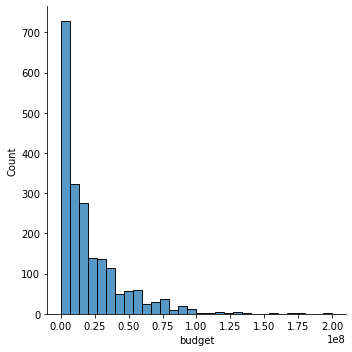

In [52]:
#About 1600 movies dont have budget value (ie roughly 50% is missing or NA)
#Budget doesnt seems to be reliable
sns.displot(movie_summary_v3[~(movie_summary_v3["budget"] == 0)]["budget"],kde=False,bins=30)

<AxesSubplot:>

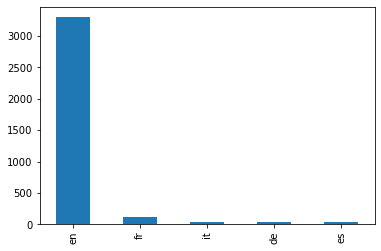

In [53]:
#Maximum movies (3299) are english movies (more than 90%)
movie_summary_v3["original_language"].value_counts().head(5).plot(kind='bar')

In [54]:
#Top 5 sequels that are made
movie_summary_v3["original_title"].value_counts().head(5)

Hamlet                    4
The Mummy                 3
The Jungle Book           2
Miracle on 34th Street    2
The Nutty Professor       2
Name: original_title, dtype: int64

In [55]:
#Top  5 production countries
movie_summary_v3["production_countries"].value_counts().head(5)

[{'iso_3166_1': 'US', 'name': 'United States of America'}]                                                    2389
[{'iso_3166_1': 'GB', 'name': 'United Kingdom'}]                                                               176
[{'iso_3166_1': 'GB', 'name': 'United Kingdom'}, {'iso_3166_1': 'US', 'name': 'United States of America'}]     146
[]                                                                                                             125
[{'iso_3166_1': 'FR', 'name': 'France'}]                                                                        65
Name: production_countries, dtype: int64

In [56]:
#Top 5 movies wrt revenue
#revenue also about 1500 movies revenue is also missing
movie_summary_v3.sort_values(by = ["revenue"], ascending = [False])["title"].head(5)

713                                       Titanic (1997)
1661    Star Wars: Episode I - The Phantom Menace (1999)
3167                                Jurassic Park (1993)
3467                       Independence Day (ID4) (1996)
100                    E.T. the Extra-Terrestrial (1982)
Name: title, dtype: object

In [57]:
#Top 5 movies wrt budget
movie_summary_v3.sort_values(by = ["budget"], ascending = [False])["title"].head(5)

713                     Titanic (1997)
1074                 Waterworld (1995)
1739             Wild Wild West (1999)
1877          13th Warrior, The (1999)
552     Speed 2: Cruise Control (1997)
Name: title, dtype: object

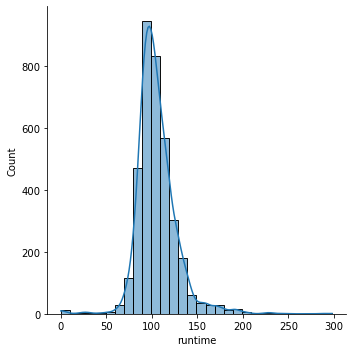

In [58]:
#max movies are 80min to 130 min
#It is somewhat normally distributed (which is natural)
sns.displot(movie_summary_v3["runtime"],bins=30,kde = True)

In [59]:
#all are released movies
movie_summary_v3["status"].value_counts()

Released    3666
Name: status, dtype: int64

In [60]:
#Only 3 movies have video
#all are released movies
movie_summary_v3["video"].value_counts()
movie_summary_v3["video"]==True

0       False
1       False
2       False
3       False
4       False
        ...  
3680    False
3681    False
3682    False
3683    False
3684    False
Name: video, Length: 3685, dtype: bool

# train test split of data

## 1) Stratified K fold

In [ ]:
stratified_k_fold_data = ratings[["userId","movieId","rating"]]

In [ ]:
X = stratified_k_fold_data.drop("rating",axis=1)

In [ ]:
Y = stratified_k_fold_data["rating"]

In [ ]:
type(Y)

In [ ]:
from sklearn.model_selection import StratifiedKFold
skf = StratifiedKFold(n_splits=5,shuffle = True,random_state=121)

In [ ]:
test_indices = []
train_indices = []
for train, test in skf.split(X, Y):
    test_indices.append(test)
    train_indices.append(train)

In [ ]:
test = pd.DataFrame(test_indices)
train = pd.DataFrame(train_indices)

In [ ]:
(test.T).to_csv('Test_indices.csv',index=False) 
(train.T).to_csv('Train_indices.csv',index=False)

In [ ]:
type(test_indices[0])

In [ ]:
#pandas dataframe can take numpy arrays as it is
ratings.iloc[test_indices[0]].head(1)

In [ ]:
sns.displot(ratings.iloc[test_indices[4]]["rating"],kde=False,bins=30) 

In [ ]:
#ratings distribution is similar as per original mix of ratings
sns.displot(ratings.iloc[train_indices[4]]["rating"],kde=False,bins=30) 

## Checking The homogeneity of Train vs Test set

In [ ]:
def splits_homogeneity (test_indices,train_indices,column_name):
    print(ratings.iloc[train_indices[2]][column_name].value_counts(normalize=True))
    print(ratings.iloc[test_indices[2]][column_name].value_counts(normalize=True))

In [ ]:
splits_homogeneity(test_indices,train_indices,"gender")

In [ ]:
splits_homogeneity(test_indices,train_indices,"age")

In [ ]:
splits_homogeneity(test_indices,train_indices,"occupation")

In [ ]:
splits_homogeneity(test_indices,train_indices,"year")

In [ ]:
ratings.iloc[train_indices[4]]["movieId"].nunique()

In [ ]:
ratings["movieId"].nunique()

In [ ]:
## After making word vectors of the column overview in the data

In [4]:
movies = pd.read_csv("movies_wise_summary_V3.csv")

In [3]:
ratings = pd.read_csv("ratings_v2.csv")

In [4]:
movies_cols_overview_features = pd.read_csv("movies_cols_overview_features.csv")

In [5]:
movies_cols_overview_features

,movie_ID,0,1,2,3,4,5,6,7,8,...,290,291,292,293,294,295,296,297,298,299
0,1,-0.007683,0.026384,0.006943,0.034335,-0.021393,0.004546,0.007327,0.000506,-0.019714,...,0.038329,-0.008168,-0.037093,0.021605,-0.004748,-0.004782,-0.011903,0.076273,-0.022052,0.018435
1,10,-0.020265,-0.045637,0.012036,0.017123,-0.030701,-0.008272,0.002981,0.017303,-0.020702,...,0.080073,0.019278,-0.071625,0.022033,-0.027286,-0.001103,0.004762,0.101693,-0.015776,-0.000312
2,100,0.021511,-0.051671,0.024168,-0.028965,-0.003095,-0.007089,0.000030,0.021638,-0.025406,...,0.090319,0.005812,-0.049035,0.037827,-0.000083,-0.006398,-0.009938,0.160763,-0.004070,0.008144
3,1000,-0.007633,-0.045600,-0.000904,-0.006689,-0.025241,0.001934,0.034892,0.022041,-0.016284,...,0.032207,0.006866,-0.050663,0.028056,-0.020245,-0.002881,-0.008910,0.093447,-0.006515,0.010875
4,1002,0.011450,-0.023481,0.015800,-0.005494,-0.058987,-0.016749,-0.034590,0.000491,0.003089,...,0.035812,-0.015754,-0.116949,0.015472,-0.025483,-0.023112,0.000031,0.184257,-0.013806,0.014121
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3680,994,-0.009432,0.005526,0.004546,0.044878,-0.009361,0.010226,0.018335,0.010930,-0.035502,...,0.045952,0.002105,-0.048846,-0.003807,-0.014541,-0.010892,-0.010246,0.107004,0.002195,0.014557
3681,996,-0.010360,-0.037774,0.001074,0.037739,-0.058099,-0.013744,0.047996,0.002472,-0.028401,...,0.054765,0.011577,-0.083370,0.024208,-0.021920,0.005003,-0.004654,0.157088,-0.008884,0.014273
3682,997,-0.001485,-0.059191,0.000441,0.030991,-0.039763,0.007942,0.033427,0.011748,-0.009260,...,0.032922,0.008482,-0.063593,0.034524,-0.033866,-0.012385,-0.006279,0.125288,-0.002714,0.012083
3683,998,-0.002131,-0.008336,-0.004438,0.007600,-0.046508,0.002474,0.020970,0.013058,-0.018263,...,0.015412,-0.000063,-0.085070,0.021058,-0.029216,-0.007364,0.006484,0.102255,-0.020328,0.006228


In [6]:
movie_vectors = movies_cols_overview_features.drop("movie_ID",axis=1)

In [7]:
movie_vectors.head(2)

,0,1,2,3,4,5,6,7,8,9,...,290,291,292,293,294,295,296,297,298,299
0,-0.007683,0.026384,0.006943,0.034335,-0.021393,0.004546,0.007327,0.000506,-0.019714,0.009722,...,0.038329,-0.008168,-0.037093,0.021605,-0.004748,-0.004782,-0.011903,0.076273,-0.022052,0.018435
1,-0.020265,-0.045637,0.012036,0.017123,-0.030701,-0.008272,0.002981,0.017303,-0.020702,-0.003864,...,0.080073,0.019278,-0.071625,0.022033,-0.027286,-0.001103,0.004762,0.101693,-0.015776,-0.000312


In [8]:
from sklearn.metrics.pairwise import cosine_similarity

In [9]:
cos_similarity  = cosine_similarity(movie_vectors.values)

In [10]:
cos_similarity_df = pd.DataFrame(cos_similarity)

In [11]:
cos_similarity_df.head(2)

,0,1,2,3,4,5,6,7,8,9,...,3675,3676,3677,3678,3679,3680,3681,3682,3683,3684
0,1.000000,0.849731,0.831016,0.815379,0.802069,0.871640,0.842294,0.872186,0.741375,0.835267,...,0.868910,0.890684,0.856132,0.834561,0.740658,0.835383,0.849279,0.841945,0.878668,0.805298
1,0.849731,1.000000,0.916288,0.920571,0.830521,0.921048,0.934463,0.835550,0.754897,0.917020,...,0.903258,0.881474,0.922610,0.915137,0.715783,0.866716,0.932248,0.899895,0.931181,0.910736


In [12]:
cos_similarity_df.columns = list(movies_cols_overview_features["movie_ID"])

In [13]:
cos_similarity_df.index = list(movies_cols_overview_features["movie_ID"])

In [14]:
cos_similarity_df.nlargest(5, [10]).index

Int64Index([10, 3248, 3301, 3286, 3627], dtype='int64')

In [15]:
#importing the test indices and the train indices
test_indices = pd.read_csv("Test_indices")
test_indices = test_indices.fillna(value=0)
test_indices = test_indices.astype(int)
test_indices = test_indices.round()

train_indices = pd.read_csv("Train_indices")
train_indices = train_indices.fillna(value=0)
train_indices = train_indices.astype(int)
train_indices =train_indices.round()


In [ ]:
#1st Fixing length of recommendation to be 5
def recomm_len_check (count,cos_similarity_df,list_of_movies_hist_orig,i):
    List_of_recommendations=[]
    recommendation_movie_i = set(cos_similarity_df.nlargest(5+count,i).index)
    list_of_movies_hist_dummy =list_of_movies_hist_orig.copy()
    list_of_movies_hist_dummy.update(recommendation_movie_i)
    
    if (len(list_of_movies_hist_dummy) == len(list_of_movies_hist_orig) +5): #because the both elements are sets (only 5 predictions per movie will come out)
        recommendation_movie_i = (recommendation_movie_i).difference(list_of_movies_hist_orig) #gives out the non common elements as predictions
        List_of_recommendations = list(recommendation_movie_i)
        
    else:
        count =count + (5-(len(list_of_movies_hist_dummy) - len(list_of_movies_hist_orig)))
        List_of_recommendations = recomm_len_check(count,cos_similarity_df,list_of_movies_hist_orig,i)
    return List_of_recommendations

In [ ]:


def recommendation (cos_similarity_df,movie_meta_data_miss,ratings,user_id):
    #creating distinct movie history of a particular user
    list_of_movies_hist = ratings[ratings["userId"] == user_id]["movieId"]
    list_of_movies_hist_orig = set(list_of_movies_hist).difference(set(movie_meta_data_miss))
    
    master_df = pd.DataFrame(index =[0,1,2,3,4])

    #list_of_Recommendation is list of Just Recommended Movies 
    #movie_seq is the order of movies in which recommendation is given
    movie_seq =[]
    #recommending top 5 movies
    for i in set(list_of_movies_hist_orig):
        count=0
        list_of_Recom_temp = recomm_len_check(count,cos_similarity_df,list_of_movies_hist_orig,i)
        df = pd.DataFrame(list_of_Recom_temp,columns=[i])
        master_df = pd.concat([master_df,df],axis=1)
    return master_df



In [ ]:
#this list of movies does not have meta data thats why removing these movies from the complete movies list 
movie_meta_data_miss = [1294,1758,1205,3935,1362,3027,3416,2645,3532,669,3366,978,3482,1741,863,811,1494,557,3842,578,1868] 

In [ ]:
#list of distinct UserID
list_of_user_ids = list(set(ratings["userId"]))
metric_df=pd.DataFrame(columns=["userID","metric","inter_section_count","movie_Recomm_count"])

In [ ]:
ratings["userId"].drop_duplicates().to_csv('userID_distinct.csv',index=False) 

#for user_id in list_of_user_ids:
# for user_id in list_of_user_ids:

In [ ]:
##*******START FROM HERE
train_data = ratings.iloc[train_indices["0"]]#change 0 to choose different split
test_movieid_userid  = ratings.iloc[test_indices["0"]][["movieId","userId"]]# can change the indice as per split column
   
for user_id in list_of_user_ids:
     recommendation_df_per_user = recommendation(cos_similarity_df,movie_meta_data_miss, ratings = train_data,user_id = user_id ) #change 1 ie user_id for which recommendation needs to be done  
    #flattening the dataframe and making unique recommendations
    
    #recommendation_df_per_user = pd.DataFrame(List_of_recommendations,index =movie_seq)
    unique_recommendations = np.unique(recommendation_df_per_user.to_numpy().flatten())

    #making unique movies out of test data for a particular USER
    test_movies_userid = test_movieid_userid[test_movieid_userid["userId"]==user_id]#change the 1 written for user id
    test_movies =  np.unique(test_movies_userid["movieId"].to_numpy().flatten())
    if len(test_movies) != 0:
        metric = len(np.intersect1d(unique_recommendations, test_movies)) / (len(test_movies))
        metric_df.loc[len(metric_df.index)] = [user_id,metric,len(np.intersect1d(unique_recommendations, test_movies)),len(unique_recommendations)] 
        print(metric_df.shape)
    else:
        continue
        

    

In [ ]:
metric_df.to_csv('metric_df',index=False)


In [ ]:
metric_df.to_csv('metric_df_v2.csv',index=False) 

## Surprise Library

In [16]:
from surprise import SVD
from surprise import Dataset
from surprise.model_selection import cross_validate
from surprise import accuracy
from surprise import Reader

In [17]:
svd = SVD(n_epochs=20,verbose=True) 
# (RMSE TRAIN AND validation)
# metrics in surprise (precision @K recall @K)

In [18]:
reader = Reader(rating_scale=(1, 5))

In [19]:
#making a surprise data object
trainset = Dataset.load_from_df(ratings[["userId","movieId",'rating']].iloc[train_indices["0"]],reader)
trainset = trainset.build_full_trainset()
testset = Dataset.load_from_df(ratings[["userId","movieId",'rating']].iloc[test_indices["0"]],reader)
testset = testset.build_full_trainset()

In [ ]:
svd.fit(trainset)

In [ ]:
ratings[ratings["rating"]==3].head(2)

In [ ]:
#uid = user id , iid = item id
svd.predict(uid=999, iid=1960)

In [ ]:
list_movies = ratings["movieId"].unique()
list_users = ratings["userId"].unique()

In [ ]:
predicted_rating_matrix = np.zeros((len(list_users),len(list_movies)))
predicted_rating_matrix = pd.DataFrame(predicted_rating_matrix,index=list_users,columns=list_movies)

In [ ]:
#predicted_rating_matrix it is the whole matrix for all the combinations of users and movieIDs
for i in list_users:
    for j in list_movies:
        predicted_rating_matrix.loc[i,j] = svd.predict(uid=i, iid=j).est
        print([i,j])

In [ ]:
predicted_rating_matrix.to_csv('SVD_Predicted_rating.csv',index=False)
predicted_rating_matrix.to_csv('SVD_Predicted_rating.csv')

In [ ]:
predicted_rating_matrix = pd.read_csv("SVD_Predicted_rating.csv",index_col=["index"])
type(predicted_rating_matrix)

In [ ]:
predicted_rating_matrix

In [ ]:
cols = pd.read_csv("cols.csv")
cols = cols["cols"].astype(int)

In [ ]:
cols.values

In [ ]:
predicted_rating_matrix.columns = cols.values

In [ ]:
predicted_rating_matrix.head(2)

In [ ]:
list_of_user_ids = set(ratings["userId"])
list_of_movies = set(ratings["movieId"])

In [ ]:
pred_movie_vs_user = predicted_rating_matrix.T

In [ ]:
pred_movie_vs_user.head(2)

In [ ]:
#Top 10 Recommendations basis svd predicted matrix and removing those movies which the user has already seen
df2_cum = pd.DataFrame(np.zeros((10,1)))

test_movieid_userid  = ratings.iloc[test_indices["0"]][["movieId","userId"]]# can change the indice as per split column
metric_df=pd.DataFrame(columns=["userID","metric","inter_section_count","movie_Recomm_count"])
training_data = ratings.iloc[train_indices["0"]][["movieId","userId"]]

for users in list(list_of_user_ids):
    #creating distinct movie history of a particular user
    list_of_movies_hist = (training_data[training_data["userId"] == users]["movieId"])
    #total movies - training data
    list_of_movies_possible = list(list_of_movies.difference(set(list_of_movies_hist)))
    recommendation_movie_i = set(pred_movie_vs_user.loc[list_of_movies_possible,:].nlargest(10,users).index)

    df1 = pd.DataFrame(recommendation_movie_i,columns=[users])
    df2_cum = pd.concat([df2_cum,df1],axis=1)

    test_movies_userid = test_movieid_userid[test_movieid_userid["userId"]==users]#change the 1 written for user id
    test_movies =  np.unique(test_movies_userid["movieId"].to_numpy().flatten())
    
    if len(test_movies) != 0:
        metric = len(np.intersect1d(np.array(list(recommendation_movie_i)), test_movies)) / (len(test_movies))
        metric_df.loc[len(metric_df.index)] = [users,metric,len(np.intersect1d(np.array(list(recommendation_movie_i)), test_movies)),len(np.array(list(recommendation_movie_i)))] 
        print(metric_df.shape)
    else:
        continue

In [ ]:
metric_df.to_csv('SVD_Output_10.csv',index=False)

### SVD optimization

In [ ]:
svd = SVD(n_epochs=10,verbose=True) 
# (RMSE TRAIN AND validation)
# metrics in surprise (precision @K recall @K)

In [ ]:
#making a surprise data object
trainset = Dataset.load_from_df(ratings[["userId","movieId",'rating']].iloc[train_indices["0"]],reader)
trainset = trainset.build_full_trainset()

In [ ]:
svd.fit(trainset)

In [ ]:
trainset = Dataset.load_from_df(ratings[["userId","movieId",'rating']].iloc[train_indices["0"]],reader)
testset = Dataset.load_from_df(ratings[["userId","movieId",'rating']].iloc[test_indices["0"]],reader)

In [ ]:
#in actual we are not doing any test_train split (this is only done so that accuracy function of surprise package could have been applied)

from surprise.model_selection import train_test_split
a , b_train = train_test_split(trainset, test_size=1.00)

In [ ]:
a , b_test = train_test_split(testset, test_size=1.00)

In [ ]:
predictions_test = svd.test(b_test)
predictions_train = svd.test(b_train)

In [ ]:
from surprise import accuracy
accuracy.rmse(predictions_test)
accuracy.rmse(predictions_train)

In [ ]:
#checking for performance on varying epochs
from surprise.model_selection import train_test_split
#epochs_count = [0,1,2,3,4,5,6,7,8,9,10,15,16,20,21,25,30,35,40,50,60,70,100]
epochs_count = [17,18,19,20]
trainset = Dataset.load_from_df(ratings[["userId","movieId",'rating']].iloc[train_indices["0"]],reader)
testset = Dataset.load_from_df(ratings[["userId","movieId",'rating']].iloc[test_indices["0"]],reader)

trainset_v2_only_training = trainset.build_full_trainset()

df_epochs = pd.DataFrame(columns=["epochs","RMSE_Train","RMSE_Test"])

In [ ]:
for epochs in epochs_count:
    svd = SVD(n_epochs=epochs)
    a , b_train = train_test_split(trainset, test_size=1.00)
    a , b_test = train_test_split(testset, test_size=1.00)
    svd.fit(trainset_v2_only_training)
    
    predictions_train = svd.test(b_train)
    predictions_test = svd.test(b_test)
    
    train = accuracy.rmse(predictions_train)
    test = accuracy.rmse(predictions_test)
    
    df_epochs.loc[len(df_epochs.index)] = [epochs,train,test]

In [ ]:
df_epochs.to_csv('SVD_optimization_more_examples.csv',index=False)

In [ ]:
df_epochs.to_csv('SVD_optimization',index=False)

In [ ]:
df_epochs.to_csv('SVD_optimization.csv',index=False) 

In [ ]:
#precision@k and recall@k

In [ ]:
from collections import defaultdict
from surprise import Dataset
from surprise import SVD
from surprise.model_selection import KFold


def precision_recall_at_k(predictions, k=10, threshold=3.5):
    """Return precision and recall at k metrics for each user"""

    # First map the predictions to each user.
    user_est_true = defaultdict(list)
    for uid, _, true_r, est, _ in predictions:
        user_est_true[uid].append((est, true_r))

    precisions = dict()
    recalls = dict()
    for uid, user_ratings in user_est_true.items():

        # Sort user ratings by estimated value
        user_ratings.sort(key=lambda x: x[0], reverse=True)

        # Number of relevant items
        n_rel = sum((true_r >= threshold) for (_, true_r) in user_ratings)

        # Number of recommended items in top k
        n_rec_k = sum((est >= threshold) for (est, _) in user_ratings[:k])

        # Number of relevant and recommended items in top k
        n_rel_and_rec_k = sum(((true_r >= threshold) and (est >= threshold))
                              for (est, true_r) in user_ratings[:k])

        # Precision@K: Proportion of recommended items that are relevant
        # When n_rec_k is 0, Precision is undefined. We here set it to 0.

        precisions[uid] = n_rel_and_rec_k / n_rec_k if n_rec_k != 0 else 0

        # Recall@K: Proportion of relevant items that are recommended
        # When n_rel is 0, Recall is undefined. We here set it to 0.

        recalls[uid] = n_rel_and_rec_k / n_rel if n_rel != 0 else 0

    return precisions, recalls


data =  Dataset.load_from_df(ratings[["userId","movieId",'rating']],reader)
kf = KFold(n_splits=5)
algo = SVD()


for trainset, testset in kf.split(data):
    algo.fit(trainset)
    predictions = algo.test(testset)
    precisions, recalls = precision_recall_at_k(predictions, k=10, threshold=3)

    # Precision and recall can then be averaged over all users
    
    print(sum(prec for prec in precisions.values()) / len(precisions))
    print(sum(rec for rec in recalls.values()) / len(recalls))

In [23]:
#top K recommendations
from surprise import SVD
from surprise import Dataset
from surprise.model_selection import cross_validate
from surprise import accuracy
from surprise import Reader

svd = SVD(n_epochs=20,verbose=True) 
# (RMSE TRAIN AND validation)
# metrics in surprise (precision @K recall @K)

reader = Reader(rating_scale=(1, 5))

#making a surprise data object
svd.fit(trainset)

list_movies = ratings["movieId"].unique()
list_users = ratings["userId"].unique()

predicted_rating_matrix = np.zeros((len(list_users),len(list_movies)))
predicted_rating_matrix = pd.DataFrame(predicted_rating_matrix,index=list_users,columns=list_movies)

#predicted_rating_matrix it is the whole matrix for all the combinations of users and movieIDs
for i in list_users:
    for j in list_movies:
        predicted_rating_matrix.loc[i,j] = svd.predict(uid=i, iid=j).est

predicted_rating_matrix.to_csv('SVD_Predicted_rating_v2.csv',index=False)


cols = pd.read_csv("cols.csv")
cols = cols["cols"].astype(int)

predicted_rating_matrix.columns = cols.values

predicted_rating_matrix.head(2)

list_of_user_ids = set(ratings["userId"])
list_of_movies = set(ratings["movieId"])

Processing epoch 0
Processing epoch 1
Processing epoch 2
Processing epoch 3
Processing epoch 4
Processing epoch 5
Processing epoch 6
Processing epoch 7
Processing epoch 8
Processing epoch 9
Processing epoch 10
Processing epoch 11
Processing epoch 12
Processing epoch 13
Processing epoch 14
Processing epoch 15
Processing epoch 16
Processing epoch 17
Processing epoch 18
Processing epoch 19


In [25]:
pred_movie_vs_user = predicted_rating_matrix.T

pred_movie_vs_user.head(2)

#Top 10 Recommendations basis svd predicted matrix and removing those movies which the user has already seen
df2_cum = pd.DataFrame(np.zeros((10,1)))

test_movieid_userid  = ratings.iloc[test_indices["0"]][["movieId","userId"]]# can change the indice as per split column
metric_df=pd.DataFrame(columns=["userID","metric_recall","metric_precision","inter_section_count","movie_Recomm_count"])
training_data = ratings.iloc[train_indices["0"]][["movieId","userId"]]
#using test dataset to control the no of recommendations
testing_data = ratings.iloc[test_indices["0"]][["movieId","userId"]]
for users in list(list_of_user_ids):
    #creating distinct movie history of a particular user
    list_of_movies_hist = (training_data[training_data["userId"] == users]["movieId"])
    length_of_recommendation = (testing_data[testing_data["userId"] == users]["movieId"]).nunique()
    #total movies - training data
    list_of_movies_possible = list(list_of_movies.difference(set(list_of_movies_hist)))
    recommendation_movie_i = set(pred_movie_vs_user.loc[list_of_movies_possible,:].nlargest(length_of_recommendation,users).index)

    test_movies_userid = test_movieid_userid[test_movieid_userid["userId"]==users]#change the 1 written for user id
    test_movies =  np.unique(test_movies_userid["movieId"].to_numpy().flatten())
    
    if len(test_movies) != 0:
        metric_recall = len(np.intersect1d(np.array(list(recommendation_movie_i)), test_movies)) / (len(test_movies))
        metric_precision = len(np.intersect1d(np.array(list(recommendation_movie_i)), test_movies))/ len(np.array(list(recommendation_movie_i)))
        metric_df.loc[len(metric_df.index)] = [users,metric_recall,metric_precision,len(np.intersect1d(np.array(list(recommendation_movie_i)), test_movies)),len(np.array(list(recommendation_movie_i)))] 
        print(metric_df.shape)
    else:
        continue

(1, 5)
(2, 5)
(3, 5)
(4, 5)
(5, 5)
(6, 5)
(7, 5)
(8, 5)
(9, 5)
(10, 5)
(11, 5)
(12, 5)
(13, 5)
(14, 5)
(15, 5)
(16, 5)
(17, 5)
(18, 5)
(19, 5)
(20, 5)
(21, 5)
(22, 5)
(23, 5)
(24, 5)
(25, 5)
(26, 5)
(27, 5)
(28, 5)
(29, 5)
(30, 5)
(31, 5)
(32, 5)
(33, 5)
(34, 5)
(35, 5)
(36, 5)
(37, 5)
(38, 5)
(39, 5)
(40, 5)
(41, 5)
(42, 5)
(43, 5)
(44, 5)
(45, 5)
(46, 5)
(47, 5)
(48, 5)
(49, 5)
(50, 5)
(51, 5)
(52, 5)
(53, 5)
(54, 5)
(55, 5)
(56, 5)
(57, 5)
(58, 5)
(59, 5)
(60, 5)
(61, 5)
(62, 5)
(63, 5)
(64, 5)
(65, 5)
(66, 5)
(67, 5)
(68, 5)
(69, 5)
(70, 5)
(71, 5)
(72, 5)
(73, 5)
(74, 5)
(75, 5)
(76, 5)
(77, 5)
(78, 5)
(79, 5)
(80, 5)
(81, 5)
(82, 5)
(83, 5)
(84, 5)
(85, 5)
(86, 5)
(87, 5)
(88, 5)
(89, 5)
(90, 5)
(91, 5)
(92, 5)
(93, 5)
(94, 5)
(95, 5)
(96, 5)
(97, 5)
(98, 5)
(99, 5)
(100, 5)
(101, 5)
(102, 5)
(103, 5)
(104, 5)
(105, 5)
(106, 5)
(107, 5)
(108, 5)
(109, 5)
(110, 5)
(111, 5)
(112, 5)
(113, 5)
(114, 5)
(115, 5)
(116, 5)
(117, 5)
(118, 5)
(119, 5)
(120, 5)
(121, 5)
(122, 5)
(123, 5)
(

(924, 5)
(925, 5)
(926, 5)
(927, 5)
(928, 5)
(929, 5)
(930, 5)
(931, 5)
(932, 5)
(933, 5)
(934, 5)
(935, 5)
(936, 5)
(937, 5)
(938, 5)
(939, 5)
(940, 5)
(941, 5)
(942, 5)
(943, 5)
(944, 5)
(945, 5)
(946, 5)
(947, 5)
(948, 5)
(949, 5)
(950, 5)
(951, 5)
(952, 5)
(953, 5)
(954, 5)
(955, 5)
(956, 5)
(957, 5)
(958, 5)
(959, 5)
(960, 5)
(961, 5)
(962, 5)
(963, 5)
(964, 5)
(965, 5)
(966, 5)
(967, 5)
(968, 5)
(969, 5)
(970, 5)
(971, 5)
(972, 5)
(973, 5)
(974, 5)
(975, 5)
(976, 5)
(977, 5)
(978, 5)
(979, 5)
(980, 5)
(981, 5)
(982, 5)
(983, 5)
(984, 5)
(985, 5)
(986, 5)
(987, 5)
(988, 5)
(989, 5)
(990, 5)
(991, 5)
(992, 5)
(993, 5)
(994, 5)
(995, 5)
(996, 5)
(997, 5)
(998, 5)
(999, 5)
(1000, 5)
(1001, 5)
(1002, 5)
(1003, 5)
(1004, 5)
(1005, 5)
(1006, 5)
(1007, 5)
(1008, 5)
(1009, 5)
(1010, 5)
(1011, 5)
(1012, 5)
(1013, 5)
(1014, 5)
(1015, 5)
(1016, 5)
(1017, 5)
(1018, 5)
(1019, 5)
(1020, 5)
(1021, 5)
(1022, 5)
(1023, 5)
(1024, 5)
(1025, 5)
(1026, 5)
(1027, 5)
(1028, 5)
(1029, 5)
(1030, 5)
(1031,

(1752, 5)
(1753, 5)
(1754, 5)
(1755, 5)
(1756, 5)
(1757, 5)
(1758, 5)
(1759, 5)
(1760, 5)
(1761, 5)
(1762, 5)
(1763, 5)
(1764, 5)
(1765, 5)
(1766, 5)
(1767, 5)
(1768, 5)
(1769, 5)
(1770, 5)
(1771, 5)
(1772, 5)
(1773, 5)
(1774, 5)
(1775, 5)
(1776, 5)
(1777, 5)
(1778, 5)
(1779, 5)
(1780, 5)
(1781, 5)
(1782, 5)
(1783, 5)
(1784, 5)
(1785, 5)
(1786, 5)
(1787, 5)
(1788, 5)
(1789, 5)
(1790, 5)
(1791, 5)
(1792, 5)
(1793, 5)
(1794, 5)
(1795, 5)
(1796, 5)
(1797, 5)
(1798, 5)
(1799, 5)
(1800, 5)
(1801, 5)
(1802, 5)
(1803, 5)
(1804, 5)
(1805, 5)
(1806, 5)
(1807, 5)
(1808, 5)
(1809, 5)
(1810, 5)
(1811, 5)
(1812, 5)
(1813, 5)
(1814, 5)
(1815, 5)
(1816, 5)
(1817, 5)
(1818, 5)
(1819, 5)
(1820, 5)
(1821, 5)
(1822, 5)
(1823, 5)
(1824, 5)
(1825, 5)
(1826, 5)
(1827, 5)
(1828, 5)
(1829, 5)
(1830, 5)
(1831, 5)
(1832, 5)
(1833, 5)
(1834, 5)
(1835, 5)
(1836, 5)
(1837, 5)
(1838, 5)
(1839, 5)
(1840, 5)
(1841, 5)
(1842, 5)
(1843, 5)
(1844, 5)
(1845, 5)
(1846, 5)
(1847, 5)
(1848, 5)
(1849, 5)
(1850, 5)
(1851, 5)


(2572, 5)
(2573, 5)
(2574, 5)
(2575, 5)
(2576, 5)
(2577, 5)
(2578, 5)
(2579, 5)
(2580, 5)
(2581, 5)
(2582, 5)
(2583, 5)
(2584, 5)
(2585, 5)
(2586, 5)
(2587, 5)
(2588, 5)
(2589, 5)
(2590, 5)
(2591, 5)
(2592, 5)
(2593, 5)
(2594, 5)
(2595, 5)
(2596, 5)
(2597, 5)
(2598, 5)
(2599, 5)
(2600, 5)
(2601, 5)
(2602, 5)
(2603, 5)
(2604, 5)
(2605, 5)
(2606, 5)
(2607, 5)
(2608, 5)
(2609, 5)
(2610, 5)
(2611, 5)
(2612, 5)
(2613, 5)
(2614, 5)
(2615, 5)
(2616, 5)
(2617, 5)
(2618, 5)
(2619, 5)
(2620, 5)
(2621, 5)
(2622, 5)
(2623, 5)
(2624, 5)
(2625, 5)
(2626, 5)
(2627, 5)
(2628, 5)
(2629, 5)
(2630, 5)
(2631, 5)
(2632, 5)
(2633, 5)
(2634, 5)
(2635, 5)
(2636, 5)
(2637, 5)
(2638, 5)
(2639, 5)
(2640, 5)
(2641, 5)
(2642, 5)
(2643, 5)
(2644, 5)
(2645, 5)
(2646, 5)
(2647, 5)
(2648, 5)
(2649, 5)
(2650, 5)
(2651, 5)
(2652, 5)
(2653, 5)
(2654, 5)
(2655, 5)
(2656, 5)
(2657, 5)
(2658, 5)
(2659, 5)
(2660, 5)
(2661, 5)
(2662, 5)
(2663, 5)
(2664, 5)
(2665, 5)
(2666, 5)
(2667, 5)
(2668, 5)
(2669, 5)
(2670, 5)
(2671, 5)


(3392, 5)
(3393, 5)
(3394, 5)
(3395, 5)
(3396, 5)
(3397, 5)
(3398, 5)
(3399, 5)
(3400, 5)
(3401, 5)
(3402, 5)
(3403, 5)
(3404, 5)
(3405, 5)
(3406, 5)
(3407, 5)
(3408, 5)
(3409, 5)
(3410, 5)
(3411, 5)
(3412, 5)
(3413, 5)
(3414, 5)
(3415, 5)
(3416, 5)
(3417, 5)
(3418, 5)
(3419, 5)
(3420, 5)
(3421, 5)
(3422, 5)
(3423, 5)
(3424, 5)
(3425, 5)
(3426, 5)
(3427, 5)
(3428, 5)
(3429, 5)
(3430, 5)
(3431, 5)
(3432, 5)
(3433, 5)
(3434, 5)
(3435, 5)
(3436, 5)
(3437, 5)
(3438, 5)
(3439, 5)
(3440, 5)
(3441, 5)
(3442, 5)
(3443, 5)
(3444, 5)
(3445, 5)
(3446, 5)
(3447, 5)
(3448, 5)
(3449, 5)
(3450, 5)
(3451, 5)
(3452, 5)
(3453, 5)
(3454, 5)
(3455, 5)
(3456, 5)
(3457, 5)
(3458, 5)
(3459, 5)
(3460, 5)
(3461, 5)
(3462, 5)
(3463, 5)
(3464, 5)
(3465, 5)
(3466, 5)
(3467, 5)
(3468, 5)
(3469, 5)
(3470, 5)
(3471, 5)
(3472, 5)
(3473, 5)
(3474, 5)
(3475, 5)
(3476, 5)
(3477, 5)
(3478, 5)
(3479, 5)
(3480, 5)
(3481, 5)
(3482, 5)
(3483, 5)
(3484, 5)
(3485, 5)
(3486, 5)
(3487, 5)
(3488, 5)
(3489, 5)
(3490, 5)
(3491, 5)


(4212, 5)
(4213, 5)
(4214, 5)
(4215, 5)
(4216, 5)
(4217, 5)
(4218, 5)
(4219, 5)
(4220, 5)
(4221, 5)
(4222, 5)
(4223, 5)
(4224, 5)
(4225, 5)
(4226, 5)
(4227, 5)
(4228, 5)
(4229, 5)
(4230, 5)
(4231, 5)
(4232, 5)
(4233, 5)
(4234, 5)
(4235, 5)
(4236, 5)
(4237, 5)
(4238, 5)
(4239, 5)
(4240, 5)
(4241, 5)
(4242, 5)
(4243, 5)
(4244, 5)
(4245, 5)
(4246, 5)
(4247, 5)
(4248, 5)
(4249, 5)
(4250, 5)
(4251, 5)
(4252, 5)
(4253, 5)
(4254, 5)
(4255, 5)
(4256, 5)
(4257, 5)
(4258, 5)
(4259, 5)
(4260, 5)
(4261, 5)
(4262, 5)
(4263, 5)
(4264, 5)
(4265, 5)
(4266, 5)
(4267, 5)
(4268, 5)
(4269, 5)
(4270, 5)
(4271, 5)
(4272, 5)
(4273, 5)
(4274, 5)
(4275, 5)
(4276, 5)
(4277, 5)
(4278, 5)
(4279, 5)
(4280, 5)
(4281, 5)
(4282, 5)
(4283, 5)
(4284, 5)
(4285, 5)
(4286, 5)
(4287, 5)
(4288, 5)
(4289, 5)
(4290, 5)
(4291, 5)
(4292, 5)
(4293, 5)
(4294, 5)
(4295, 5)
(4296, 5)
(4297, 5)
(4298, 5)
(4299, 5)
(4300, 5)
(4301, 5)
(4302, 5)
(4303, 5)
(4304, 5)
(4305, 5)
(4306, 5)
(4307, 5)
(4308, 5)
(4309, 5)
(4310, 5)
(4311, 5)


(5032, 5)
(5033, 5)
(5034, 5)
(5035, 5)
(5036, 5)
(5037, 5)
(5038, 5)
(5039, 5)
(5040, 5)
(5041, 5)
(5042, 5)
(5043, 5)
(5044, 5)
(5045, 5)
(5046, 5)
(5047, 5)
(5048, 5)
(5049, 5)
(5050, 5)
(5051, 5)
(5052, 5)
(5053, 5)
(5054, 5)
(5055, 5)
(5056, 5)
(5057, 5)
(5058, 5)
(5059, 5)
(5060, 5)
(5061, 5)
(5062, 5)
(5063, 5)
(5064, 5)
(5065, 5)
(5066, 5)
(5067, 5)
(5068, 5)
(5069, 5)
(5070, 5)
(5071, 5)
(5072, 5)
(5073, 5)
(5074, 5)
(5075, 5)
(5076, 5)
(5077, 5)
(5078, 5)
(5079, 5)
(5080, 5)
(5081, 5)
(5082, 5)
(5083, 5)
(5084, 5)
(5085, 5)
(5086, 5)
(5087, 5)
(5088, 5)
(5089, 5)
(5090, 5)
(5091, 5)
(5092, 5)
(5093, 5)
(5094, 5)
(5095, 5)
(5096, 5)
(5097, 5)
(5098, 5)
(5099, 5)
(5100, 5)
(5101, 5)
(5102, 5)
(5103, 5)
(5104, 5)
(5105, 5)
(5106, 5)
(5107, 5)
(5108, 5)
(5109, 5)
(5110, 5)
(5111, 5)
(5112, 5)
(5113, 5)
(5114, 5)
(5115, 5)
(5116, 5)
(5117, 5)
(5118, 5)
(5119, 5)
(5120, 5)
(5121, 5)
(5122, 5)
(5123, 5)
(5124, 5)
(5125, 5)
(5126, 5)
(5127, 5)
(5128, 5)
(5129, 5)
(5130, 5)
(5131, 5)


(5852, 5)
(5853, 5)
(5854, 5)
(5855, 5)
(5856, 5)
(5857, 5)
(5858, 5)
(5859, 5)
(5860, 5)
(5861, 5)
(5862, 5)
(5863, 5)
(5864, 5)
(5865, 5)
(5866, 5)
(5867, 5)
(5868, 5)
(5869, 5)
(5870, 5)
(5871, 5)
(5872, 5)
(5873, 5)
(5874, 5)
(5875, 5)
(5876, 5)
(5877, 5)
(5878, 5)
(5879, 5)
(5880, 5)
(5881, 5)
(5882, 5)
(5883, 5)
(5884, 5)
(5885, 5)
(5886, 5)
(5887, 5)
(5888, 5)
(5889, 5)
(5890, 5)
(5891, 5)
(5892, 5)
(5893, 5)
(5894, 5)
(5895, 5)
(5896, 5)
(5897, 5)
(5898, 5)
(5899, 5)
(5900, 5)
(5901, 5)
(5902, 5)
(5903, 5)
(5904, 5)
(5905, 5)
(5906, 5)
(5907, 5)
(5908, 5)
(5909, 5)
(5910, 5)
(5911, 5)
(5912, 5)
(5913, 5)
(5914, 5)
(5915, 5)
(5916, 5)
(5917, 5)
(5918, 5)
(5919, 5)
(5920, 5)
(5921, 5)
(5922, 5)
(5923, 5)
(5924, 5)
(5925, 5)
(5926, 5)
(5927, 5)
(5928, 5)
(5929, 5)
(5930, 5)
(5931, 5)
(5932, 5)
(5933, 5)
(5934, 5)
(5935, 5)
(5936, 5)
(5937, 5)
(5938, 5)
(5939, 5)
(5940, 5)
(5941, 5)
(5942, 5)
(5943, 5)
(5944, 5)
(5945, 5)
(5946, 5)
(5947, 5)
(5948, 5)
(5949, 5)
(5950, 5)
(5951, 5)


In [26]:
metric_df.to_csv('recommendation_test_size.csv',index=False) 

In [ ]:
train_indices["0"]

In [ ]:
#WHAT IS THE DEFINATION OF X in group K fold
#Group K fold does not works for multiple variables (only one column at a time is utilised)
ratings.info()

## Graph model_Building

In [15]:
import networkx as nx
import matplotlib.pyplot as plt

In [16]:
ratings=pd.read_csv("ratings_v2.csv")

In [17]:
ratings.columns

Index(['userId', 'movieId', 'rating', 'title', 'genres', 'year', 'meta_data',
       'gender', 'age', 'occupation', 'zipcode'],
      dtype='object')

In [25]:
ratings_original = ratings[["userId","movieId","rating"]].copy()

In [26]:
ratings_original.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000209 entries, 0 to 1000208
Data columns (total 3 columns):
 #   Column   Non-Null Count    Dtype
---  ------   --------------    -----
 0   userId   1000209 non-null  int64
 1   movieId  1000209 non-null  int64
 2   rating   1000209 non-null  int64
dtypes: int64(3)
memory usage: 22.9 MB


In [74]:
Recommender_Graph_my = nx.Graph()

In [75]:
list_user_nodes = list(ratings_original["userId"].unique())

In [76]:
Recommender_Graph_my.add_nodes_from(list_user_nodes,type = "UserID")

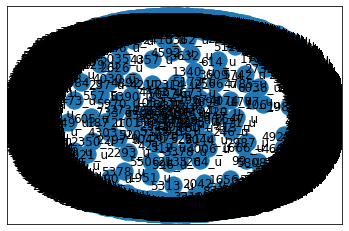

In [67]:
nx.draw_networkx(Recommender_Graph_my)

In [77]:
Recommender_Graph_my.nodes(data=True)

NodeDataView({1: {'type': 'UserID'}, 10: {'type': 'UserID'}, 100: {'type': 'UserID'}, 1000: {'type': 'UserID'}, 1001: {'type': 'UserID'}, 1002: {'type': 'UserID'}, 1003: {'type': 'UserID'}, 1004: {'type': 'UserID'}, 1005: {'type': 'UserID'}, 1006: {'type': 'UserID'}, 1007: {'type': 'UserID'}, 1008: {'type': 'UserID'}, 1009: {'type': 'UserID'}, 101: {'type': 'UserID'}, 1010: {'type': 'UserID'}, 1011: {'type': 'UserID'}, 1012: {'type': 'UserID'}, 1013: {'type': 'UserID'}, 1014: {'type': 'UserID'}, 1015: {'type': 'UserID'}, 1016: {'type': 'UserID'}, 1017: {'type': 'UserID'}, 1018: {'type': 'UserID'}, 1019: {'type': 'UserID'}, 102: {'type': 'UserID'}, 1020: {'type': 'UserID'}, 1021: {'type': 'UserID'}, 1022: {'type': 'UserID'}, 1023: {'type': 'UserID'}, 1024: {'type': 'UserID'}, 1025: {'type': 'UserID'}, 1026: {'type': 'UserID'}, 1027: {'type': 'UserID'}, 1028: {'type': 'UserID'}, 1029: {'type': 'UserID'}, 103: {'type': 'UserID'}, 1030: {'type': 'UserID'}, 1031: {'type': 'UserID'}, 1032: {

In [78]:
list_movies = list(ratings_original["movieId"].unique())

In [79]:
Recommender_Graph_my.add_nodes_from(list_movies,type = "movieID")

In [82]:
movie_nodes = [Recommender_Graph_my.nodes for x,y in Recommender_Graph_my.nodes(data=True) if y['type']=="movieID"]

In [85]:
User_nodes = [Recommender_Graph_my.nodes for x,y in Recommender_Graph_my.nodes(data=True) if y['type']=="UserID"]

In [97]:
info(Recommender_Graph_my,)

NameError: name 'info' is not defined

In [16]:
User_Nodes = [Recommender_Graph.nodes for x,y in Recommender_Graph.nodes(data=True) if y['type']=="UserID"]

In [31]:
count=0
for i in User_Nodes:
    for j in movie_nodes:
        if ((ratings_original[(ratings_original["userId"]==a) & (ratings_original["movieId"]==c)]["rating"].isnull()):
            count=count+1
            
#             Recommender_Graph.add_edge((a,b),(c,d),weight =ratings_original[(ratings_original["userId"]==a) & (ratings_original["movieId"]==c)]["rating"] )
        else:
            continue

ValueError: too many values to unpack (expected 2)

In [ ]:
#SIR Method

In [20]:
ratings_original.head(3)

,userId,movieId,rating
0,1,1,5
1,1,2692,4
2,1,2762,4


In [27]:
ratings_original[['userId','movieId']] =ratings_original[['userId', 'movieId']].astype(str)

In [28]:
ratings_original.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000209 entries, 0 to 1000208
Data columns (total 3 columns):
 #   Column   Non-Null Count    Dtype 
---  ------   --------------    ----- 
 0   userId   1000209 non-null  object
 1   movieId  1000209 non-null  object
 2   rating   1000209 non-null  int64 
dtypes: int64(1), object(2)
memory usage: 22.9+ MB


In [29]:
ratings_original["userId"] = ratings_original["userId"]+"_u"  #u subscript for user

In [30]:
ratings_original["movieId"] = ratings_original["movieId"]+"_m" #m subscript for the movie

In [32]:
Recommender_Graph = nx.from_pandas_edgelist(ratings_original,source ="userId",target="movieId", edge_attr="rating")

In [33]:
Recommender_Graph.nodes

NodeView(('1_u', '1_m', '2692_m', '2762_m', '2791_m', '2797_m', '2804_m', '2918_m', '3105_m', '3114_m', '3186_m', '3408_m', '48_m', '527_m', '531_m', '588_m', '594_m', '595_m', '608_m', '661_m', '720_m', '745_m', '783_m', '919_m', '938_m', '2687_m', '260_m', '914_m', '2355_m', '2398_m', '1022_m', '1029_m', '1035_m', '1097_m', '1193_m', '1197_m', '1207_m', '1246_m', '1270_m', '1287_m', '150_m', '1028_m', '1566_m', '1545_m', '2321_m', '2294_m', '2028_m', '2018_m', '2340_m', '1961_m', '1907_m', '1836_m', '1721_m', '1962_m', '10_u', '3066_m', '3100_m', '3099_m', '3097_m', '3095_m', '3087_m', '3086_m', '3072_m', '3108_m', '2997_m', '3037_m', '3035_m', '3034_m', '2968_m', '2967_m', '2959_m', '2948_m', '2946_m', '3153_m', '292_m', '3039_m', '3155_m', '3255_m', '317_m', '3363_m', '3359_m', '3358_m', '3347_m', '333_m', '3309_m', '3296_m', '329_m', '3264_m', '3259_m', '3254_m', '3252_m', '3247_m', '32_m', '3198_m', '3194_m', '3189_m', '318_m', '3175_m', '3174_m', '316_m', '2874_m', '2530_m', '28

In [36]:
Recommender_Graph.edges.data(data=True)

EdgeDataView([('1_u', '1_m', {'rating': 5}), ('1_u', '2692_m', {'rating': 4}), ('1_u', '2762_m', {'rating': 4}), ('1_u', '2791_m', {'rating': 4}), ('1_u', '2797_m', {'rating': 4}), ('1_u', '2804_m', {'rating': 5}), ('1_u', '2918_m', {'rating': 4}), ('1_u', '3105_m', {'rating': 5}), ('1_u', '3114_m', {'rating': 4}), ('1_u', '3186_m', {'rating': 4}), ('1_u', '3408_m', {'rating': 4}), ('1_u', '48_m', {'rating': 5}), ('1_u', '527_m', {'rating': 5}), ('1_u', '531_m', {'rating': 4}), ('1_u', '588_m', {'rating': 4}), ('1_u', '594_m', {'rating': 4}), ('1_u', '595_m', {'rating': 5}), ('1_u', '608_m', {'rating': 4}), ('1_u', '661_m', {'rating': 3}), ('1_u', '720_m', {'rating': 3}), ('1_u', '745_m', {'rating': 3}), ('1_u', '783_m', {'rating': 4}), ('1_u', '919_m', {'rating': 4}), ('1_u', '938_m', {'rating': 4}), ('1_u', '2687_m', {'rating': 3}), ('1_u', '260_m', {'rating': 4}), ('1_u', '914_m', {'rating': 3}), ('1_u', '2355_m', {'rating': 5}), ('1_u', '2398_m', {'rating': 4}), ('1_u', '1022_m', {

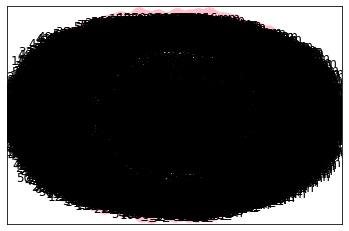

In [52]:
nx.draw_networkx(Recommender_Graph,node_color="pink")

In [ ]:
Recommender_Graph

In [ ]:
#NMF
#GMF
#Hit Ratio
#